<div align="center">

## 최적의 쏘카존 위치 찾기
</div>


### 프로젝트(1) 서울시 쏘카존 데이터를 활용한 시각화

**라이브러리 임포트 및 주요 라이브러리 버전 체크**

In [1]:
import requests
import json
import os
import math
import time
import pandas as pd
import numpy as np
import geopandas as gpd
import folium
import matplotlib.pyplot as plt

from shapely.geometry import mapping, shape, Point, Polygon, LineString
from folium import plugins
from folium.plugins import MarkerCluster, HeatMap

print(pd.__version__)
print(gpd.__version__)
print(folium.__version__)

1.3.3
0.10.1
0.12.1


**공간 데이터를 활용한 시각화 방법**

---
이번 프로젝트에서 공간 데이터를 활용해 시각화하는 방법에는 다양한 내용이 포함되어 있지만 시각화의 기능적인 방법론적 순서는 다음과 같이 정리할 수 있다.

1. csv/API 등을 이용해 DataFrame으로 만들기 위한 전처리
2. DataFrame 생성 후 데이터 전처리
3. 위도 경도 데이터 타입 확인
4. 좌표계 확인(WSG84)
5. Folium을 이용해 시각화

**서울시 쏘카존 데이터 불러오기**

---
데이터 로드 후 DataFrame으로 생성

In [2]:
path = os.getenv('HOME') + '/aiffel/socar_gis/data/20210823_socar_zone.csv'

socar_zone_info_df = pd.read_csv(path)
socar_zone_info_df.head()

,zone_name,lng,lat,region1,region2,region3
0,비전2 파출소사거리,127.102939,36.995989,경기도,평택시,비전동
1,수원시청역 9번출구,127.032953,37.262378,경기도,수원시 팔달구,인계동
2,목포 상동현대아파트 앞,126.415655,34.811289,전라남도,목포시,상동
3,단국대 산학협력관 앞,127.166626,36.832965,충청남도,천안시 동남구,신부동
4,목원대학교 앞,127.337858,36.329906,대전광역시,서구,도안동


In [3]:
socar_zone_info_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 4328 entries, 0 to 4327
Data columns (total 6 columns):
 #   Column     Non-Null Count  Dtype  
---  ------     --------------  -----  
 0   zone_name  4328 non-null   object 
 1   lng        4328 non-null   float64
 2   lat        4328 non-null   float64
 3   region1    4328 non-null   object 
 4   region2    4328 non-null   object 
 5   region3    4328 non-null   object 
dtypes: float64(2), object(4)
memory usage: 203.0+ KB


**Folium 초기 Map 객체 생성**

---
map의 위치는 center에 위치하고, zoom 레벨은 12로 시작.

In [4]:
# 서울시 중심부 위도, 경도
center = [37.541, 126.986]

map1 = folium.Map(
    location=center,
    zoom_start=12,
)

**MarkerCluster 객체 생성**

---
쏘카존 이름, 위도, 경도를 가져와 Marker 객체로 추가

In [5]:
# MarkerCluster 객체 생성
marker_cluster = MarkerCluster().add_to(map1)

#maker 객체 추가
for _, row in socar_zone_info_df.iterrows():
    try:
        folium.Marker(
            location=[socar_zone_info_df.loc[_, "lat"], socar_zone_info_df.loc[_, "lng"]],
            popup=socar_zone_info_df.loc[_, "zone_name"],
            icon=folium.Icon(color="cadetblue", icon="car", prefix="fa")
        ).add_to(marker_cluster)
    except:
        pass

In [6]:
map1

### 프로젝트(2) 서울시 카페와 버스 정류장 밀도 데이터를 이용한 시각화

**데이터 로드**

---
서울시 카페 밀도를 시각화하기 위해 상가 정보 데이터 불러오기.

In [7]:
temp_seoul_store_df = pd.read_csv(os.getenv('HOME') + '/aiffel/socar_gis/data/seoul_store_info_202106.csv')
temp_seoul_store_df.head()

,상가업소번호,상호명,지점명,상권업종대분류코드,상권업종대분류명,상권업종중분류코드,상권업종중분류명,상권업종소분류코드,상권업종소분류명,표준산업분류코드,...,건물관리번호,건물명,도로명주소,구우편번호,신우편번호,동정보,층정보,호정보,경도,위도
0,17174175,비지트,NaN,Q,음식,Q01,한식,Q01A01,한식/백반/한정식,I56111,...,1165010100108540018009586,상랑의빌딩,서울특별시 서초구 동광로18길 82,137837,6572.0,NaN,1,NaN,126.991394,37.488375
1,17174119,쓰리에프,NaN,Q,음식,Q01,한식,Q01A01,한식/백반/한정식,I56111,...,1159010700101390073009536,NaN,서울특별시 동작구 동작대로27가길 12,156816,7008.0,NaN,NaN,NaN,126.980952,37.487105
2,17174096,채움,NaN,Q,음식,Q01,한식,Q01A01,한식/백반/한정식,I56111,...,1111012400100580000017956,두산위브파빌리온,서울특별시 종로구 삼봉로 81,110858,3150.0,NaN,NaN,NaN,126.981794,37.572387
3,17174062,호구의주방,NaN,D,소매,D07,가정/주방/인테리어,D07A17,주방가구판매,G47520,...,1156012800101600002019768,약산상가아파트,서울특별시 영등포구 선유로 269,150867,7206.0,NaN,NaN,NaN,126.897892,37.536700
4,17174040,다향,NaN,Q,음식,Q01,한식,Q01A01,한식/백반/한정식,I56111,...,1165010800114850004022127,NaN,서울특별시 서초구 효령로 230,137869,6709.0,NaN,1,NaN,127.009382,37.483436


카페 정보가 필요하기 때문에 데이터 프레임에서 `상권업종소분루코드` 컬럼에서 'Q12A01'만 필터링한다. 참고로 Q12A01는 커피점/카페 분류코드이다. 상권정보업종 코드는 [소상공인시장진흥공단_상가(상권)정보 업종코드](https://www.data.go.kr/data/15067631/fileData.do)을 참고함.

In [8]:
seoul_cafe_store_df = temp_seoul_store_df[temp_seoul_store_df["상권업종소분류코드"] == "Q12A01"]

seoul_cafe_store_df.head()

,상가업소번호,상호명,지점명,상권업종대분류코드,상권업종대분류명,상권업종중분류코드,상권업종중분류명,상권업종소분류코드,상권업종소분류명,표준산업분류코드,...,건물관리번호,건물명,도로명주소,구우편번호,신우편번호,동정보,층정보,호정보,경도,위도
28,20659878,커피빈,코리아대학로대명거리점,Q,음식,Q12,커피점/카페,Q12A01,커피전문점/카페/다방,I56220,...,1111017200100510000032165,NaN,서울특별시 종로구 대명길 25,110524,3078.0,NaN,3,NaN,127.000171,37.583149
111,20676428,요거프레소,쌍문점,Q,음식,Q12,커피점/카페,Q12A01,커피전문점/카페/다방,I56220,...,1132010500100200000006625,NaN,서울특별시 도봉구 도당로 7,132030,1385.0,NaN,1,NaN,127.034746,37.658728
190,20695531,메머드커피,NaN,Q,음식,Q12,커피점/카페,Q12A01,커피전문점/카페/다방,I56220,...,1144012000103270015009846,NaN,서울특별시 마포구 와우산로 149,121836,4052.0,NaN,1,NaN,126.929692,37.554599
197,28491095,우성커피숍,NaN,Q,음식,Q12,커피점/카페,Q12A01,커피전문점/카페/다방,I56220,...,1147010300105140002010707,NaN,서울특별시 양천구 오목로 48,158090,8029.0,NaN,1,NaN,126.842935,37.522055
225,20815616,카페클럽,NaN,Q,음식,Q12,커피점/카페,Q12A01,커피전문점/카페/다방,I56220,...,1171010800100430006004404,NaN,서울특별시 송파구 동남로2길 3-6,138200,5805.0,NaN,1,NaN,127.122480,37.488907


위도와 경도의 데이터 타입 확인. `float`가 아닐시 `float`로 변경.

In [9]:
seoul_cafe_store_df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 20481 entries, 28 to 315945
Data columns (total 39 columns):
 #   Column     Non-Null Count  Dtype  
---  ------     --------------  -----  
 0   상가업소번호     20481 non-null  int64  
 1   상호명        20481 non-null  object 
 2   지점명        7320 non-null   object 
 3   상권업종대분류코드  20481 non-null  object 
 4   상권업종대분류명   20481 non-null  object 
 5   상권업종중분류코드  20481 non-null  object 
 6   상권업종중분류명   20481 non-null  object 
 7   상권업종소분류코드  20481 non-null  object 
 8   상권업종소분류명   20481 non-null  object 
 9   표준산업분류코드   19124 non-null  object 
 10  표준산업분류명    19124 non-null  object 
 11  시도코드       20481 non-null  int64  
 12  시도명        20481 non-null  object 
 13  시군구코드      20481 non-null  int64  
 14  시군구명       20481 non-null  object 
 15  행정동코드      20481 non-null  int64  
 16  행정동명       20478 non-null  object 
 17  법정동코드      20481 non-null  int64  
 18  법정동명       20481 non-null  object 
 19  지번코드       20481 non-null  int64  
 20  대지구분

카페 밀도를 표현하기 위해 위치데이터 리스트를 생성.

In [10]:
seoul_cafe_location_data = [[row["위도"], row['경도']] for _, row in seoul_cafe_store_df.iterrows()]

서울시 버스 정류장 밀도 데이터 리스트 생성

In [11]:
path = os.getenv('HOME') + '/aiffel/socar_gis/data/seoul_bus_line_info.csv'
bus_line_info_df = pd.read_csv(path)
bus_line_info_df.head()

,노선ID,노선명,순번,구간ID,정류소ID,ARS-ID,정류소명,X좌표,Y좌표
0,100100124,0017,1,0,102000271,3689,청암자이아파트,126.946517,37.534363
1,100100124,0017,2,102700549,102000204,3298,청암동강변삼성아파트,126.949304,37.533961
2,100100124,0017,3,102700550,102000227,3321,청심경로당,126.950449,37.533744
3,100100124,0017,4,102700551,102000210,3304,원효2동주민센터,126.950904,37.534278
4,100100124,0017,5,102700552,102000212,3306,산천동,126.953984,37.535420


컬럼 명을 'X좌표와 Y좌표'에서 '경도와 위도'로 변경하고, 버스 정류장의 밀도를 표현해주는 위치데이터 리스트를 만든다.

In [12]:
# 컬럼명 변경
bus_line_info_df.rename(
    columns={
        "Y좌표": "위도",
        "X좌표": "경도",
    },
    inplace=True
)

bus_line_info_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 39363 entries, 0 to 39362
Data columns (total 9 columns):
 #   Column  Non-Null Count  Dtype  
---  ------  --------------  -----  
 0   노선ID    39363 non-null  int64  
 1   노선명     39363 non-null  object 
 2   순번      39363 non-null  int64  
 3   구간ID    39363 non-null  int64  
 4   정류소ID   39363 non-null  int64  
 5   ARS-ID  39363 non-null  int64  
 6   정류소명    39363 non-null  object 
 7   경도      39363 non-null  float64
 8   위도      39363 non-null  float64
dtypes: float64(2), int64(5), object(2)
memory usage: 2.7+ MB


In [13]:
# 버스 정류장 밀도를 표현해주기 위한 위치데이터 리스트 만들기
bus_station_location_data = [[row["위도"], row["경도"]] for _, row in bus_line_info_df.iterrows()]

**Heatmap 형태로 시각화하기**

---
시각화를 위해 Heatmap을 사용하는 이유는 유동성과 집객효과가 큰 곳을 확인해 쏘카존이 입지하기 유리한 조건을 확인하기 위해서이다. 상업시설의 대표격인 카페가 많이 모여 있거나 대중교통이 잘 발달된 곳이 유동성과 집객효과가 큰 곳이므로 Heatmap을 통해 카페와 버스 정류장의 밀도를 시각적으로 확인한다.

- Heatmap 사용 방법
    - Folium 초기 Map 객체를 생성. 초기 Map 메소드에는 초기 중심값 좌표가 들어가야 한다.
    - tiles 파라미터를 "Stamen Terrain"로 바꿔준다.
    - zoom_start를 15로 설정.

In [14]:
# Folium 초기 Map 객체 생성

# 서울시 중심부 위도, 경도
center = [37.541, 126.986]

map1 = folium.Map(
    location=center,
    tiles= "Stamen Terrain",
    zoom_start=15
)

Folium의 plugins 메소드를 이용하여 다양한 인자를 하나의 Map에 시각화.
- [Folium documentation - plugins](https://python-visualization.github.io/folium/plugins.html)

In [15]:
# 레이어 적용을 위한 그룹 만들기
# 대표 그룹 만들기
fg = folium.FeatureGroup(name="groups")
map1.add_child(fg)

# 카페 그룹 만들기
cafe = plugins.FeatureGroupSubGroup(fg, "cafe_density")
map1.add_child(cafe)

# 버스 정류장 그룹 만들기
bus_station = plugins.FeatureGroupSubGroup(fg, "bus_station_density")
map1.add_child(bus_station)

# 레이어 컨트롤 박스 만들기
folium.LayerControl(collapsed=False).add_to(map1)

카페와 버스 정류장의 밀도를 Heatmap에 추가 후 시각화.

In [16]:
# 카페 밀도
plugins.HeatMap(seoul_cafe_location_data).add_to(cafe)

In [17]:
# 버스 정류장 밀도
plugins.HeatMap(bus_station_location_data).add_to(bus_station)

In [18]:
# 생성한 맵 확인
map1

### 프로젝트(3) 시각화 자료에 쏘카존 데이터 추가하기

---

프로젝트 (1)에서 진행한 쏘카존 데이터를 프로젝트(2)에서 진행한 시각화 자료에 추가.<br>
**시각화가 모두 완료된 후에는 쏘카존에 대한 평가 및 선정 진행**

- 쏘카존 데이터를 프로젝트(2)의 시각화 자료에 추가하는 과정은 다음과 같다.
    1. Folium 사용을 위해 초기 맵 생성(프로젝트 (2) 참고)
    2. Heatmap 형식으로 생성할 레이어 적용을 위한 그룹만들기
    3. 쏘카존 마커 클러스터 만들기
    4. 카페 그룹, 버스 정류장 그룹, 쏘카존 그룹, 레이어 컨트롤 박스 만들기
    5. 카페 밀도 맵에 추가하기
    6. 버스 정류장 밀도 맵에 추가하기
    7. 쏘카존 마커 맵에 추가하기(프로젝트 (1) 참고)
    8. 생성한 맵 확인

**1. Folium 사용을 위해 초기 맵 생성**

In [19]:
# Folium 초기 Map 객체를 생성 합니다.
# 초기 Map 메소드에는 초기 중심값 좌표가 들어가야 합니다.

# 서울시 중심부 위도, 경도
center = [37.541, 126.986]

m = folium.Map(
    location=center,
    tiles= "Stamen Terrain",
    zoom_start=15
) 

**2. Heatmap 형식으로 생성할 레이어 적용을 위한 그룹 만들기**

In [20]:
# 레이어 적용을 위한 그룹 만들기
# 대표 그룹 만들기
fg = folium.FeatureGroup(name="groups")
m.add_child(fg)

**3. 쏘카존 마커 클러스터 만들기**

In [22]:
# 쏘카존 마커 클러스터 만들기
mg = plugins.MarkerCluster(
    control=False
    )

m.add_child(mg)

**4. 카페 그룹, 버스 정류장 그룹, 쏘카존 그룹, 레이어 컨트롤 박스 만들기**

In [26]:
# 카페 그룹 만들기
cafe = plugins.FeatureGroupSubGroup(fg, "cafe_density")
m.add_child(cafe)

# 버스정류장 그룹 만들기
bus_station = plugins.FeatureGroupSubGroup(fg, "bus_station_density")
m.add_child(bus_station)

# 쏘카존 마커 그룹 만들기
socar_zone = MarkerCluster().add_to(m)
    
# 레이어 컨트롤 박스 만들기
folium.LayerControl(collapsed=False).add_to(m)

**5. 카페 밀도 맵에 추가하기**

In [27]:
# 카페 밀도
plugins.HeatMap(seoul_cafe_location_data).add_to(cafe)

**6. 버스 정류장 밀도 맵에 추가하기**

In [28]:
# 버스 정류장 밀도
plugins.HeatMap(bus_station_location_data).add_to(bus_station)

**7. 쏘카존 마커 맵에 추가하기**

In [29]:
# maker 객체 추가
# 쏘카존 마커
for _, row in socar_zone_info_df.iterrows():
    try:
        folium.Marker(
            location=[socar_zone_info_df.loc[_, "lat"], socar_zone_info_df.loc[_, "lng"]],
            popup=socar_zone_info_df.loc[_, "zone_name"],
            icon=folium.Icon(color="cadetblue", icon="car", prefix="fa")
        ).add_to(socar_zone)
    except:
        pass

**8. 생성한 맵 확인**

In [30]:
m

**쏘카존에 대한 평가 및 선정**

---
Q.완성된 시각화 자료를 토대로 자신만의 분석을 진행해주시길 바랍니다. 만약 여러분이 쏘카존 담당자라고 가정하고 현재 쏘카존의 위치가 적절한 지 판단해봅시다. 여러 장소를 확인해보세요! 신규 쏘카존의 적절한 위치는 어디가 좋을지 고민하여 이미지로 표시하고 그 이유를 적어봅시다.

---

사실 행정구역별 가동률 까지 시각화를 시켰으면 좀 더 효율적으로 분석을 할 수 있을 것 같다라는 생각이 먼저 들었다. 일단 시각화된 자료를 보자면,

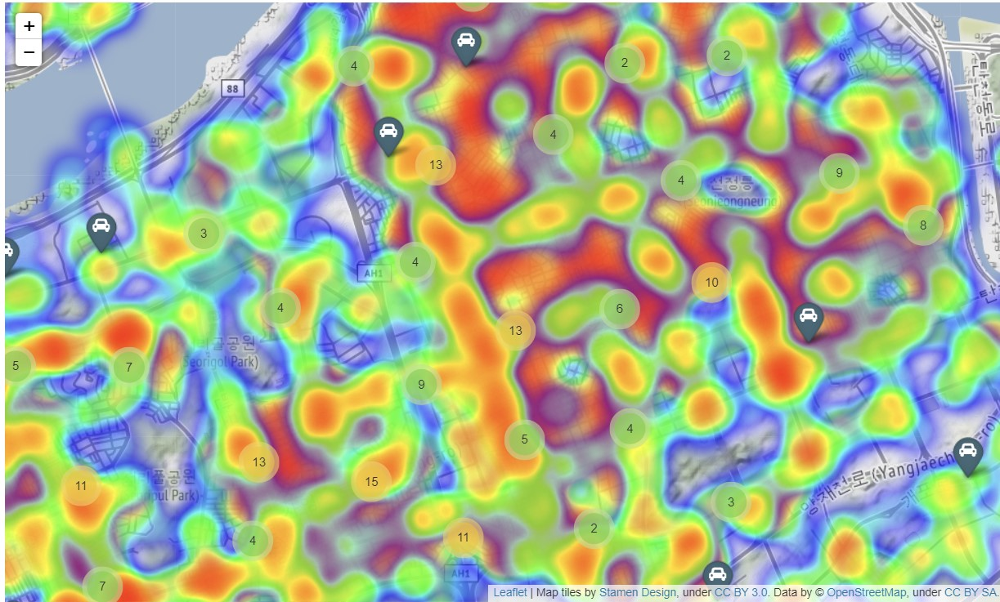

카페가 밀집된 지역 보다는 그 변방에 쏘카존이 위치해 있으며, 대교를 낀 곳 근처에도 쏘카존이 위치해 있는 모습을 볼 수 있다. 추가적으로

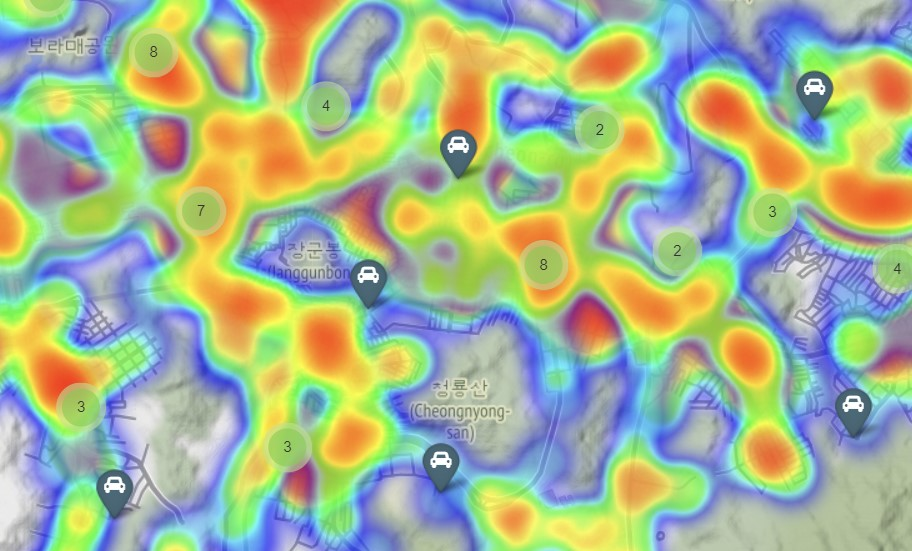

카페나 버스 정류장이 밀집된 지역보다는 아무래도 아파트나 빌라단지 또는 대학교 근처에 많이 위치해 있는 모습을 볼 수 있다. 아무래도 상권이 발달된 곳이 접근성은 좋겠지만, 접근성이 좋은 만큼 그 지역의 주차요금, 대중교통이 발달하여 렌트수요에는 긍정적인 영향을 미치지는 못하는 것 같다. 반면에 대학가나 외진 곳의 아파트 단지 및 빌라 지역 등에는 아직 차를 소유하지 못한 대학생들의 렌트 수요 비중, 외진지역에서 다리를 넘어 출근을 하는 직장인 등 여러 방면으로 수요가 충족이 되는 경향을 띄었으니 그쪽 위주로 쏘카존이 많이 활성화가 된 것 같다. 정확히는 행정동별 가동률을 봐야 알 수 있겠지만 당장 이렇게만 놓고 본다면, 서울 지역에서는 짧은 거리 위주의 렌트를 할 확률이 높으니 번화가 주위 변방에 쏘카존을 더 확충하거나 서울의 대교 쪽 및 공원이나 산 위주 또는 서울 외곽쪽 위주로 쏘카존을 더 늘리면 좋을 것 같다.